# Card detection with Keras Yolov3

As best practice, I will try to keep each part independent, therefore one can go directly to the willing section.

But before that, you must run the first cells from imports, config and global variables.

From here https://github.com/qqwweee/keras-yolo3

In [1]:
%matplotlib inline

In [2]:
# IMPORTS
import math
import random
from pathlib import Path

import numpy as np
import pandas as pd
import pickle
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches
import tensorflow as tf
from tensorflow import keras
from PIL import Image, ImageDraw
import cv2

import imgaug as ia
from imgaug import augmenters as iaa
from shapely.geometry import Polygon

In [3]:
# GLOBAL VARIABLES
BACKGROUNDS_PICKLE = 'resources/dtd/backgrounds.pck'
HAND_IMAGE = 'resources/hand_real.png'
LABELS_PATH = 'resources/labels.txt'
CARDS_PICKLE = 'resources/card.pck'
PAIRS_299x299 = '/Users/allan/Development/Champop/jupyter/resources/pairs_299x299'

BLUE = "#0000ff"

# GEN_WIDTH,GEN_HEIGHT: dimensions of the generated dataset images 
GEN_WIDTH=720
GEN_HEIGHT=720

def reload_background():
    global background
    background = Image.open(HAND_IMAGE)
    
def reload_labels():
    with open(LABELS_PATH) as f:
        global labels
        labels = f.read().splitlines()

In [136]:
# Diplay OpenCV images in a jupyter cell
def imshow(img, contours=[], mode="bgr", title=''):
    out_img = img.copy()
    if not isinstance(contours, list):
        contours = [contours]
    if contours:
        cv2.drawContours(out_img, contours, -1,(255,255,0),6)
    if len(out_img.shape) == 3 and mode == "bgr":
        out_img = out_img[:,:,::-1]
    if len(out_img.shape) == 3 and mode == "rgb":
        out_img = out_img[:,:,:-1]
    plt.imshow(out_img)
    plt.title(title)
    plt.show()

    
def give_me_filename(dir_path, base, suffix='.png'):
    bname="%09d"%random.randint(0,999999999)
    return Path(dir_path) / f"{base}_{bname}{suffix}"

## Dataset Creation

We must create a dataset with the right format.

In [ ]:
# HELPERS
def pasteLeftCard(card, background):
    width, height = card.size
    out = card.resize((159, 237))
    box = (0, 0, math.ceil(width/2.1), math.ceil(height/2))
    region = out.crop(box)
    background.paste(region, (882, 1000))
    return background

def pasteRightCard(card, background):
    width, height = card.size
    out = card.resize((159, 237))
    box = (0, 0, math.ceil(width), math.ceil(height/2))
    region = out.crop(box)
    background.paste(region, (942, 1000))
    return background

In [ ]:
# Load single card images
path_cards = Path.cwd() / 'resources' / 'card_images'
files = path_cards.glob('**/*.png')
files = [x for x in files]
file = files[0] ; file

## Attent to recreate hands

In [ ]:
background = Image.open(HAND_IMAGE)
draw = ImageDraw.Draw(background)

y_min = 202
y_max = 313
x_min = 280
x_split = 333
x_max = 473

draw.line((x_min,y_min, x_min,y_max), fill=500)
draw.line((x_split,y_min, x_split,y_max), fill=500)
draw.line((x_min,y_min, x_max,y_min), fill=500)
draw.line((x_max,y_min, x_max,y_max), fill=500)
draw.line((x_min,y_max, x_max,y_max), fill=500)
background

In [ ]:
card = Image.open(file)
draw = ImageDraw.Draw(card)

width, height = card.size
x_max = math.ceil(width/2.1)
y_max = math.ceil(height/2 + )
draw.rectangle([(0, 0), (x_max,y_max)], width=2, fill=None, outline=BLUE)
card

In [ ]:
card = Image.open(file)
draw = ImageDraw.Draw(card)

width, height = card.size
x_max = math.ceil(width)
y_max = math.ceil(height/2)
draw.rectangle([(0, 0), (x_max,y_max)], width=2, fill=None, outline=BLUE)
card

[array([[[168, 157, 155],
         [169, 158, 156],
         [171, 160, 158],
         ...,
         [227, 216, 212],
         [227, 216, 212],
         [227, 216, 212]],
 
        [[168, 157, 155],
         [170, 159, 157],
         [172, 161, 159],
         ...,
         [227, 216, 212],
         [227, 216, 212],
         [227, 216, 212]],
 
        [[169, 158, 156],
         [172, 161, 159],
         [175, 164, 162],
         ...,
         [227, 216, 212],
         [227, 216, 212],
         [227, 216, 212]],
 
        ...,
 
        [[218, 216, 217],
         [218, 216, 217],
         [219, 217, 218],
         ...,
         [224, 224, 226],
         [224, 224, 226],
         [225, 225, 227]],
 
        [[218, 216, 217],
         [218, 216, 217],
         [219, 217, 218],
         ...,
         [224, 224, 226],
         [224, 224, 226],
         [225, 225, 227]],
 
        [[220, 218, 219],
         [220, 218, 219],
         [219, 217, 218],
         ...,
         [225, 225, 227],
  

# Test solution from 

[https://github.com/geaxgx/playing-card-detection/blob/master/creating_playing_cards_dataset.ipynb]

In [ ]:
file = random.choice(files)
card = Image.open(file)
draw = ImageDraw.Draw(card)

width, height = card.size
x_max = math.ceil(width/2.5)
y_max = math.ceil(height/1.7)
draw.rectangle([(0, 0), (x_max,y_max)], width=2, fill=None, outline=BLUE)
card

In [24]:
def findHull(img, debug="no"):
    """
        Find in the zone 'corner' of image 'img' and return, the convex hull delimiting
        the value and suit symbols
        'corner' (shape (4,2)) is an array of 4 points delimiting a rectangular zone, 
        takes one of the 2 possible values : refCornerHL or refCornerLR
        debug=
    """
    
    kernel = np.ones((10,10),np.uint8)
    
    width, height = img.shape[:2]
    x_max = math.ceil(width/2.5)
    y_max = math.ceil(height/1.7)
    corner = np.array([[0,0],
                      [x_max,0],
                      [x_max,y_max],
                      [0,y_max]],dtype=np.int)
    
    # We will focus on the zone of 'img' delimited by 'corner'
    height, width = img.shape[:2]
    x1=0
    y1=0
    x2=math.ceil(width/2.5)
    y2=math.ceil(height/1.7)
    w=x2-x1
    h=y2-y1
    zone=img[y1:y2,x1:x2].copy()
#     imshow(zone)

    gray=cv2.cvtColor(zone,cv2.COLOR_BGR2GRAY)
    thld=cv2.Canny(gray,30,200)
#     imshow(thld)
    thld = cv2.dilate(thld,kernel,iterations=1)
#     imshow(thld)

    contours,_= cv2.findContours(thld.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
#     imshow(zone, contours=contours)

    min_area=30 # We will reject contours with small area. TWEAK, 'zoom' dependant
    min_solidity=0.3 # Reject contours with a low solidity. TWEAK

    concat_contour=None # We will aggregate in 'concat_contour' the contours that we want to keep

    ok=True
    for c in contours:
        area=cv2.contourArea(c)

        hull = cv2.convexHull(c)
        hull_area = cv2.contourArea(hull)
        solidity = float(area)/hull_area
        # Determine the center of gravity (cx,cy) of the contour
        M=cv2.moments(c)
        cx=int(M['m10']/M['m00'])
        cy=int(M['m01']/M['m00'])
        #  abs(w/2-cx)<w*0.3 and abs(h/2-cy)<h*0.4 : TWEAK, the idea here is to keep only the contours which are closed to the center of the zone
        if area >= min_area and abs(w/2-cx)<w*0.3 and abs(h/2-cy)<h*0.4 and solidity>min_solidity:
            if debug != "no" :
                cv2.drawContours(zone,[c],0,(255,0,0),-1)
            if concat_contour is None:
                concat_contour=c
            else:
                concat_contour=np.concatenate((concat_contour,c))

    #             imshow(zone, contours=[concat_contour])

    if concat_contour is not None:
        # At this point, we suppose that 'concat_contour' contains only the contours corresponding the value and suit symbols   
        # We can now determine the hull
        hull=cv2.convexHull(concat_contour)
        hull_area=cv2.contourArea(hull)
        # If the area of the hull is to small or too big, there may be a problem
        min_hull_area=940 # TWEAK, deck and 'zoom' dependant
        max_hull_area=2120 # TWEAK, deck and 'zoom' dependant
        if hull_area < min_hull_area or hull_area > max_hull_area: 
            ok=False
            if debug!="no":
                print("Hull area=",hull_area,"too large or too small")
        # So far, the coordinates of the hull are relative to 'zone'
        # We need the coordinates relative to the image -> 'hull_in_img' 
        hull_in_img=hull+corner[0]
    
    return hull_in_img

In [ ]:
debug="true"
bugs = []
for file in files:
    card = cv2.imread(str(file))
    hull_card = findHull(card)

    if hull_card.shape[0] < 10 :
        print( " Wrong card",file.name, hull_card.shape)
        bugs.append(file)

In [ ]:
# for file in bugs:
#     img = cv2.imread(str(file))
#     # (235, 158, 3)
#     resized = cv2.resize(img, (158, 235), interpolation = cv2.INTER_AREA)
#     cv2.imwrite(str(file),resized) 
    # imshow(resized)

### Loading Backgrounds

## Creation of the pickle file

In [25]:
reload_labels()
cards = {}
for label in labels :
    cards[label] = []
    file_path =  Path('resources') / 'card_images' / f"card-{label}.png"
    assert file_path.exists()

    card = cv2.imread(str(file_path))
    hull_card = findHull(card)
    if hull_card is None: 
        print(f"File {f} not used.")
        continue
    # We store the image in "rgb" format (we don't need opencv anymore)
    img=cv2.cvtColor(card,cv2.COLOR_BGRA2RGBA)
    cards[label].append((img,hull_card))


print("Saved in :",CARDS_PICKLE)
pickle.dump(cards,open(CARDS_PICKLE,'wb'))

cv2.destroyAllWindows()

Saved in : resources/card.pck


## Generate Training Dataset

## Load the backgounds pickle file in 'backgrounds'

'backgrounds' is an instance of the class Backgrounds To get a random background image, call the method : backgrounds.get_random


In [15]:
bg_images=[]
path_cards = Path.cwd() / 'resources' / 'dtd' 
files = path_cards.glob('**/**/*.jpg')
# files = [file.stem for file in files]
for file in files:
    img = mpimg.imread(str(file))
    bg_images.append(img)

print("Nb of images loaded :",len(bg_images))
# print("Saved in :",BACKGROUNDS_PICKLE)
# pickle.dump(bg_images,open(BACKGROUNDS_PICKLE,'wb'))

finish collect images
Nb of images loaded : 5640
Saved in : resources/dtd/backgrounds.pck


In [17]:
class Backgrounds():
    def __init__(self,backgrounds=bg_images):
        self._images=bg_images
        self._nb_images=len(self._images)
        print("Nb of images loaded :", self._nb_images)
    def get_random(self, display=False):
        bg=self._images[random.randint(0,self._nb_images-1)]
        if display: plt.imshow(bg)
        return bg
    
backgrounds = Backgrounds()

Nb of images loaded : 5640


### Creating the Card artefact

In [18]:
class Cards():
    def __init__(self,cards_pck_fn=CARDS_PICKLE):
        self._cards=pickle.load(open(cards_pck_fn,'rb'))
        # self._cards is a dictionary where keys are card names (ex:'Kc') and values are lists of (img,hullHL,hullLR) 
        self._nb_cards_by_value={k:len(self._cards[k]) for k in self._cards}
        print("Nb of cards loaded per name :", self._nb_cards_by_value)
        
    def get_random(self, card_name=None, display=False):
        if card_name is None:
            card_name= random.choice(list(self._cards.keys()))
        card, hull =self._cards[card_name][random.randint(0,self._nb_cards_by_value[card_name]-1)]
        if display:
            if display: imshow(card,[hull],mode="rgb")
        return card, card_name, hull
    
cards = Cards()

Nb of cards loaded per name : {'2-club': 1, '2-heart': 1, '2-spade': 1, '2-diamond': 1, '3-club': 1, '3-heart': 1, '3-spade': 1, '3-diamond': 1, '4-club': 1, '4-heart': 1, '4-spade': 1, '4-diamond': 1, '5-club': 1, '5-heart': 1, '5-spade': 1, '5-diamond': 1, '6-club': 1, '6-heart': 1, '6-spade': 1, '6-diamond': 1, '7-club': 1, '7-heart': 1, '7-spade': 1, '7-diamond': 1, '8-club': 1, '8-heart': 1, '8-spade': 1, '8-diamond': 1, '9-club': 1, '9-heart': 1, '9-spade': 1, '9-diamond': 1, '10-club': 1, '10-heart': 1, '10-spade': 1, '10-diamond': 1, 'J-club': 1, 'J-heart': 1, 'J-spade': 1, 'J-diamond': 1, 'Q-club': 1, 'Q-heart': 1, 'Q-spade': 1, 'Q-diamond': 1, 'K-club': 1, 'K-heart': 1, 'K-spade': 1, 'K-diamond': 1, 'A-club': 1, 'A-heart': 1, 'A-spade': 1, 'A-diamond': 1}


In [145]:
# Scenario with 2 cards:
# The original image of a card has the shape (cardH,cardW,4)
# We first paste it in a zero image of shape (imgH,imgW,4) at position decalX, decalY
# so that the original image is centerd in the zero image
imgW = GEN_WIDTH
imgH = GEN_HEIGHT
cardW = 158
cardH = 235
decalX=int((imgW-cardW)/2)
decalY=int((imgH-cardH)/2)

reload_labels()

# Scenario with 3 cards : decal values are different
decalX3=int(imgW/2)
decalY3=int(imgH/2-cardH)

def kps_to_polygon(kps):
    """
        Convert imgaug keypoints to shapely polygon
    """
    pts=[(kp.x,kp.y) for kp in kps]
    return Polygon(pts)

def hull_to_kps(hull, decalX=decalX, decalY=decalY):
    """
        Convert hull to imgaug keypoints
    """
    # hull is a cv2.Contour, shape : Nx1x2
    kps=[ia.Keypoint(x=p[0]+decalX,y=p[1]+decalY) for p in hull.reshape(-1,2)]
    kps=ia.KeypointsOnImage(kps, shape=(imgH,imgW,3))
    return kps

def kps_to_BB(kps):
    """
        Determine imgaug bounding box from imgaug keypoints
    """
    extend=3 # To make the bounding box a little bit bigger
    kpsx=[kp.x for kp in kps.keypoints]
    minx=max(0,int(min(kpsx)-extend))
    maxx=min(imgW,int(max(kpsx)+extend))
    kpsy=[kp.y for kp in kps.keypoints]
    miny=max(0,int(min(kpsy)-extend))
    maxy=min(imgH,int(max(kpsy)+extend))
    if minx==maxx or miny==maxy:
        return None
    else:
        return ia.BoundingBox(x1=minx,y1=miny,x2=maxx,y2=maxy)


# imgaug keypoints of the bounding box of a whole card
cardKP = ia.KeypointsOnImage([
    ia.Keypoint(x=decalX,y=decalY),
    ia.Keypoint(x=decalX+cardW,y=decalY),   
    ia.Keypoint(x=decalX+cardW,y=decalY+cardH),
    ia.Keypoint(x=decalX,y=decalY+cardH)
    ], shape=(imgH,imgW,3))

# imgaug transformation for one card in scenario with 2 cards
transform_1card = iaa.Sequential([
    iaa.Affine(scale=[0.65,1]),
    iaa.Affine(rotate=(-180,180)),
    iaa.Affine(translate_percent={"x":(-0.25,0.25),"y":(-0.25,0.25)}),
])

# For the 3 cards scenario, we use 3 imgaug transforms, the first 2 are for individual cards, 
# and the third one for the group of 3 cards
trans_rot1 = iaa.Sequential([
    iaa.Affine(translate_px={"x": (10, 20)}),
    iaa.Affine(rotate=(22,30))
])
trans_rot2 = iaa.Sequential([
    iaa.Affine(translate_px={"x": (0, 5)}),
    iaa.Affine(rotate=(10,15))
])
transform_3cards = iaa.Sequential([
    iaa.Affine(translate_px={"x":decalX-decalX3,"y":decalY-decalY3}),
    iaa.Affine(scale=[0.65,1]),
    iaa.Affine(rotate=(-180,180)),
    iaa.Affine(translate_percent={"x":(-0.2,0.2),"y":(-0.2,0.2)})   
])

# imgaug transformation for the background
scaleBg=iaa.Scale({"height": imgH, "width": imgW})

def augment(img, list_kps, seq, restart=True):
    """
        Apply augmentation 'seq' to image 'img' and keypoints 'list_kps'
        If restart is False, the augmentation has been made deterministic outside the function (used for 3 cards scenario)
    """ 
    # Make sequence deterministic
    while True:
        if restart:
            myseq=seq.to_deterministic()
        else:
            myseq=seq
        # Augment image, keypoints and bbs 
        img_aug = myseq.augment_images([img])[0]
        list_kps_aug = [myseq.augment_keypoints([kp])[0] for kp in list_kps]
        list_bbs = [kps_to_BB(list_kps_aug[1])]
        valid=True
        # Check the card bounding box stays inside the image
        for bb in list_bbs:
            if bb is None or int(round(bb.x2)) >= imgW or int(round(bb.y2)) >= imgH or int(bb.x1)<=0 or int(bb.y1)<=0:
                valid=False
                break
        if valid: break
        elif not restart:
            img_aug=None
            break
                
    return img_aug,list_kps_aug,list_bbs

class BBA:  # Bounding box + annotations
    def __init__(self,bb,classname):      
        self.x1=int(round(bb.x1))
        self.y1=int(round(bb.y1))
        self.x2=int(round(bb.x2))
        self.y2=int(round(bb.y2))
        self.classname=classname

class Scene:
    def __init__(self, bg, img1, class1, hull1, img2, class2, hull2, img3=None, class3=None,hull3=None):
        if img3 is not None:
            self.create3CardsScene(bg,img1, class1, hull1, img2, class2, hull2, img3, class3,hull3)
        else:
            self.class1=class1
            self.class2=class2
            self.class1_num = labels.index(class1)
            self.class2_num = labels.index(class2)
            self.create2CardsScene(bg,img1, class1, hull1, img2, class2, hull2)

    def create2CardsScene(self,bg,img1, class1, hull1, img2, class2, hull2):

        kps1=hull_to_kps(hull1)
        kps2=hull_to_kps(hull2)
        
        imgW = GEN_WIDTH
        imgH = GEN_HEIGHT
        
        cardH1, cardW1, _ = img1.shape
        decalX1=int((imgW-cardW1)/2)
        decalY1=int((imgH-cardH1)/2)

        # Randomly transform 1st card
        self.img1=np.zeros((imgH,imgW,4),dtype=np.uint8)
        self.img1[decalY1:decalY1+cardH1,decalX1:decalX1+cardW1,:]=img1
        self.img1,self.lkps1,self.bbs1=augment(self.img1,[cardKP,kps1],transform_1card)

        # Randomly transform 2nd card. We want that card 2 does not partially cover a corner of 1 card.
        # If so, we apply a new random transform to card 2
        while True:
            cardH2, cardW2, _ = img2.shape
            decalX2=int((imgW-cardW2)/2)
            decalY2=int((imgH-cardH2)/2)
        
            self.listbba=[]
            self.img2=np.zeros((imgH,imgW,4),dtype=np.uint8)
            self.img2[decalY2:decalY2+cardH2,decalX2:decalX2+cardW2,:]=img2
            self.img2,self.lkps2,self.bbs2=augment(self.img2,[cardKP,kps2],transform_1card)

            # mainPoly2: shapely polygon of card 2
            mainPoly2=kps_to_polygon(self.lkps2[0].keypoints[0:4])
            invalid=False
            intersect_ratio=0.1
            for i in range(1,2):
                # smallPoly1: shapely polygon of one of the hull of card 1
                smallPoly1=kps_to_polygon(self.lkps1[i].keypoints[:])
                a=smallPoly1.area
                # We calculate area of the intersection of card 1 corner with card 2
                intersect=mainPoly2.intersection(smallPoly1)
                ai=intersect.area
                # If intersection area is small enough, we accept card 2
                if (a-ai)/a > 1-intersect_ratio:
                    self.listbba.append(BBA(self.bbs1[i-1],self.class1_num))
                # If intersectio area is not small, but also not big enough, we want apply new transform to card 2
                elif (a-ai)/a>intersect_ratio:
                    invalid=True
                    break
                    
            if not invalid: break
            
        for bb in self.bbs2:
            self.listbba.append(BBA(bb,self.class2_num))
        # Construct final image of the scene by superimposing: bg, img1 and img2
        self.bg=scaleBg.augment_image(bg)
        mask1=self.img1[:,:,3]
        self.mask1=np.stack([mask1]*3,-1)
        self.final=np.where(self.mask1,self.img1[:,:,0:3],self.bg)
        mask2=self.img2[:,:,3]
        self.mask2=np.stack([mask2]*3,-1)
        self.final=np.where(self.mask2,self.img2[:,:,0:3],self.final)
        
        
        
    def create3CardsScene(self,bg,img1, class1, hull1, img2, class2, hull2, img3, class3, hull3):
        
        imgW = GEN_WIDTH
        imgH = GEN_HEIGHT
        
        cardH1, cardW1, _ = img1.shape
        decalX1=int((imgW-cardW1)/2)
        decalY1=int((imgH-cardH1)/2)    
        cardH2, cardW2, _ = img2.shape
        decalX2=int((imgW-cardW2)/2)
        decalY2=int((imgH-cardH2)/2)      
        cardH3, cardW3, _ = img3.shape
        decalX3=int((imgW-cardW3)/2)
        decalY3=int((imgH-cardH3)/2)
        
        kps1=hull_to_kps(hull1,decalX3,decalY3)
        kps2=hull_to_kps(hull2,decalX3,decalY3)
        kps3=hull_to_kps(hull3,decalX3,decalY3)
        self.img3=np.zeros((imgH,imgW,4),dtype=np.uint8)
        self.img3[decalY3:decalY3+cardH3,decalX3:decalX3+cardW3,:]=img3
        self.img3,self.lkps3,self.bbs3=augment(self.img3,[cardKP, kps3],trans_rot1)
        self.img2=np.zeros((imgH,imgW,4),dtype=np.uint8)
        self.img2[decalY2:decalY2+cardH2,decalX2:decalX2+cardW2,:]=img2
        self.img2,self.lkps2,self.bbs2=augment(self.img2,[cardKP, kps2],trans_rot2)
        self.img1=np.zeros((imgH,imgW,4),dtype=np.uint8)
        self.img1[decalY1:decalY1+cardH1,decalX1:decalX1+cardW1,:]=img1

        while True:
            det_transform_3cards = transform_3cards.to_deterministic()
            _img3,_lkps3,self.bbs3=augment(self.img3,self.lkps3,det_transform_3cards, False)
            if _img3 is None: continue
            _img2,_lkps2,self.bbs2=augment(self.img2,self.lkps2,det_transform_3cards, False)
            if _img2 is None: continue
            _img1,self.lkps1,self.bbs1=augment(self.img1,[cardKP,kps1],det_transform_3cards, False)
            if _img1 is None: continue
            break
        self.img3=_img3
        self.lkps3=_lkps3
        self.img2=_img2
        self.lkps2=_lkps2
        self.img1=_img1
        
        self.class1=class1
        self.class2=class2
        self.class3=class3
        self.listbba=[BBA(self.bbs1[0],class1),BBA(self.bbs2[0],class2),BBA(self.bbs3[0],class3)]
        
        # Construct final image of the scene by superimposing: bg, img1, img2 and img3
        self.bg=scaleBg.augment_image(bg)
        mask1=self.img1[:,:,3]
        self.mask1=np.stack([mask1]*3,-1)
        self.final=np.where(self.mask1,self.img1[:,:,0:3],self.bg)
        mask2=self.img2[:,:,3]
        self.mask2=np.stack([mask2]*3,-1)
        self.final=np.where(self.mask2,self.img2[:,:,0:3],self.final)
        mask3=self.img3[:,:,3]
        self.mask3=np.stack([mask3]*3,-1)
        self.final=np.where(self.mask3,self.img3[:,:,0:3],self.final)

    def display(self):
        fig,ax=plt.subplots(1,figsize=(8,8))
        ax.imshow(self.final)
        for bb in self.listbba:
            rect=patches.Rectangle((bb.x1,bb.y1),bb.x2-bb.x1,bb.y2-bb.y1,linewidth=1,edgecolor='b',facecolor='none')
            ax.add_patch(rect)
    def res(self):
        return self.final
    def write_files(self, file_path='resources/yolo_generated_dataset/labels.txt',display=False):
        jpg_fn = give_me_filename('resources/yolo_generated_dataset/images', f'{self.class1}_{self.class2}', '.png')
        plt.imsave(jpg_fn,self.final)
        
        annots = [f'{bb.x1},{bb.y1},{bb.x2},{bb.y2},{bb.classname}' for bb in self.listbba]
        join_annots = '\t'.join(annots)
        with open(file_path, "a") as out_file:
            out_file.write(f"{jpg_fn}\t{join_annots}\n")
        if display: print("New image saved in",jpg_fn)


/Users/allan/.local/share/virtualenvs/champop-jupyter-y4k-6Rs3/lib/python3.6/site-packages/ipykernel_launcher.py:84: DeprecationWarning: Function `Scale()` is deprecated. Use `Resize` instead. Resize has the exactly same interface as Scale.


In [142]:
reload_labels()
labels.index('7-diamond')

23

/Users/allan/.local/share/virtualenvs/champop-jupyter-y4k-6Rs3/lib/python3.6/site-packages/ipykernel_launcher.py:256: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


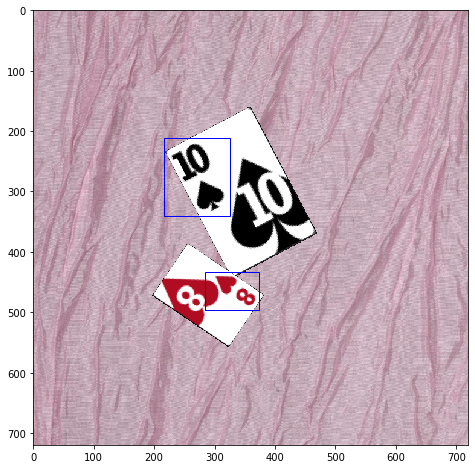

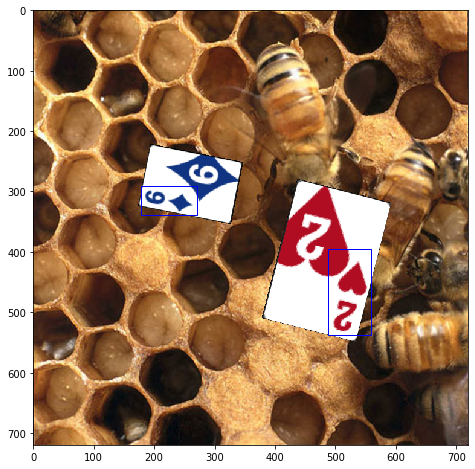

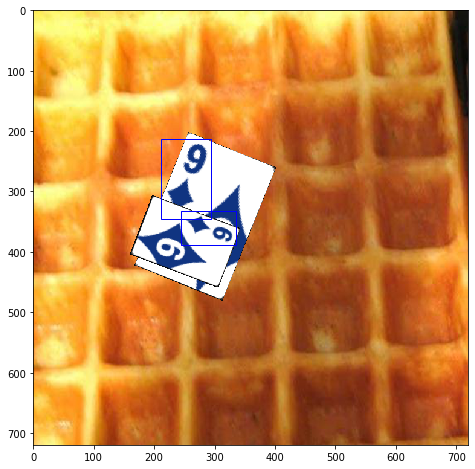

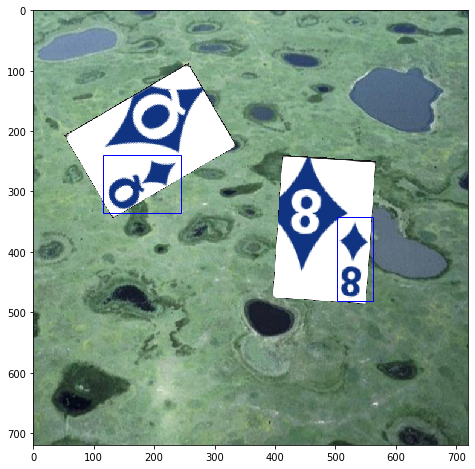

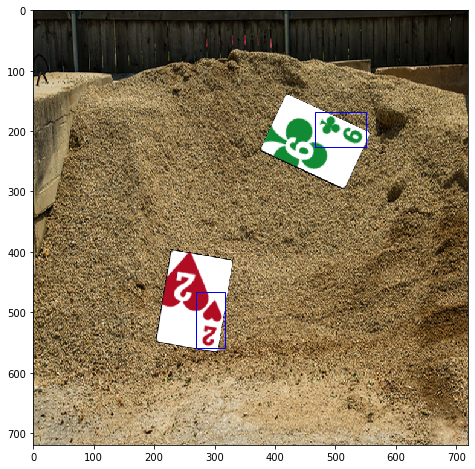

...

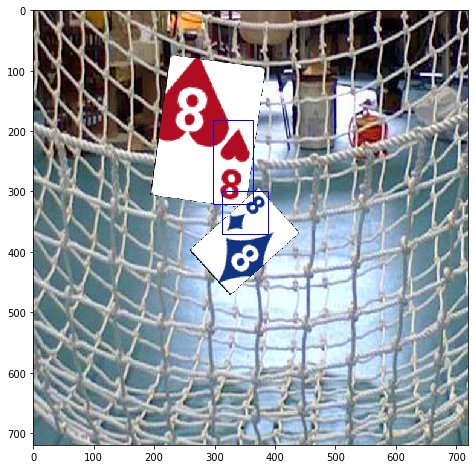

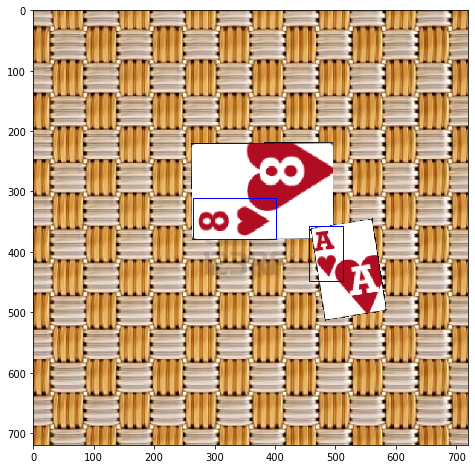

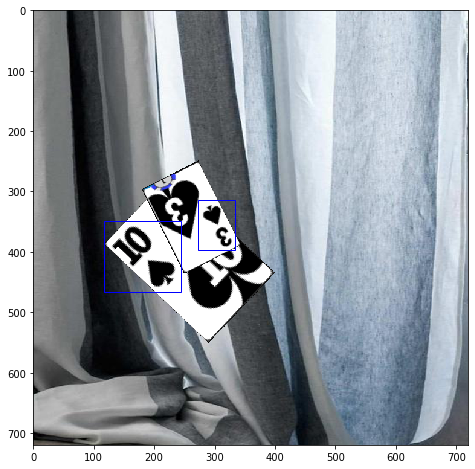

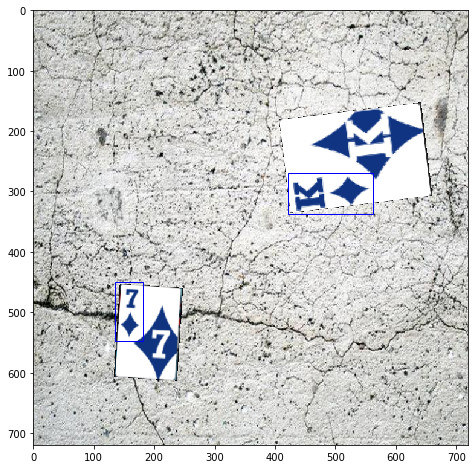

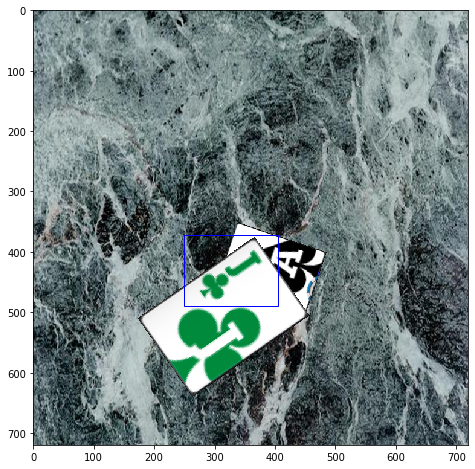

In [149]:
for _ in range(100):
    bg=backgrounds.get_random()
    img1,card_val1,hull1=cards.get_random()
    img2,card_val2,hull2=cards.get_random()
    hull1

    newimg=Scene(bg,img1,card_val1,hull1,img2,card_val2,hull2)
    newimg.write_files()
    newimg.display()

